# Interactive Mapping


## Getting Started

- Download MapPLUTO data from [NYC DCP](https://s-media.nyc.gov/agencies/dcp/assets/files/zip/data-tools/bytes/nyc_mappluto_24v1_1_shp.zip)
- Unzip the file and place contents in the `Data` directory at the root of this repo
- Make sure you have installed all requisite libraries by running `pip install -r requirements.txt` **_with your virtual environment activated_**

## Goals

- Load data from file
- Demonstrate downloading data via API
- Explore the data
- Compare tradeoffs between different methods of loading data
- Demonstrate tradeoffs in different file formats


In [1]:
# the bare minimum
import matplotlib.pyplot as plt
import geopandas as gpd

# more advanced
import pyogrio as ogr
from sklearn.cluster import KMeans
from lonboard import Map, PolygonLayer
from lonboard.colormap import apply_categorical_cmap, apply_continuous_cmap
from palettable.colorbrewer.sequential import PuRd_9
from matplotlib.colors import LogNorm

import pydeck as pdk
from IPython.display import HTML

# load PLUTO data


In [2]:
# pluto = gpd.read_file("../Data/nyc_mappluto_24v1_1_shp/MapPLUTO.shp")

In [3]:
pluto_ogrio = ogr.read_dataframe("../../Data/nyc_mappluto_24v1_1_shp/MapPLUTO.shp")

In [4]:
# type(pluto_ogrio), type(pluto)

# basic exploration


In [5]:
pluto_ogrio.columns

Index(['Borough', 'Block', 'Lot', 'CD', 'BCT2020', 'BCTCB2020', 'CT2010',
       'CB2010', 'SchoolDist', 'Council', 'ZipCode', 'FireComp', 'PolicePrct',
       'HealthCent', 'HealthArea', 'Sanitboro', 'SanitDistr', 'SanitSub',
       'Address', 'ZoneDist1', 'ZoneDist2', 'ZoneDist3', 'ZoneDist4',
       'Overlay1', 'Overlay2', 'SPDist1', 'SPDist2', 'SPDist3', 'LtdHeight',
       'SplitZone', 'BldgClass', 'LandUse', 'Easements', 'OwnerType',
       'OwnerName', 'LotArea', 'BldgArea', 'ComArea', 'ResArea', 'OfficeArea',
       'RetailArea', 'GarageArea', 'StrgeArea', 'FactryArea', 'OtherArea',
       'AreaSource', 'NumBldgs', 'NumFloors', 'UnitsRes', 'UnitsTotal',
       'LotFront', 'LotDepth', 'BldgFront', 'BldgDepth', 'Ext', 'ProxCode',
       'IrrLotCode', 'LotType', 'BsmtCode', 'AssessLand', 'AssessTot',
       'ExemptTot', 'YearBuilt', 'YearAlter1', 'YearAlter2', 'HistDist',
       'Landmark', 'BuiltFAR', 'ResidFAR', 'CommFAR', 'FacilFAR', 'BoroCode',
       'BBL', 'CondoNo', 'Tract2

In [6]:
pluto_ogrio.dtypes

Borough         object
Block            int64
Lot              int32
CD               int32
BCT2020         object
                ...   
Longitude      float64
Notes           object
Shape_Leng     float64
Shape_Area     float64
geometry      geometry
Length: 95, dtype: object

## categorical column


In [7]:
pluto_ogrio.LandUse.value_counts()

LandUse
01    565933
02    131623
04     55966
11     24904
05     21260
03     12916
08     12052
06      9431
10      9344
07      6033
09      4708
Name: count, dtype: int64

🧐 What do those numbers mean? Let's look at the [data dictionary](https://s-media.nyc.gov/agencies/dcp/assets/files/pdf/data-tools/bytes/meta_mappluto.pdf)


In [8]:
# now we can remap the numbers into something more meaningful

land_use_codes = {
    "01": "One & Two Family Buildings",
    "02": "Multi-Family Walk-Up Buildings",
    "03": "Multi-Family Elevator Buildings",
    "04": "Mixed Residential & Commercial Buildings",
    "05": "Commercial & Office Buildings",
    "06": "Industrial & Manufacturing",
    "07": "Transportation & Utility",
    "08": "Public Facilities & Institutions",
    "09": "Open Space & Outdoor Recreation",
    "10": "Parking Facilities",
    "11": "Vacant Land",
}

In [9]:
pluto_ogrio["LandUse"] = pluto_ogrio.LandUse.map(land_use_codes)

In [10]:
pluto_ogrio["LandUse"].value_counts()

LandUse
One & Two Family Buildings                  565933
Multi-Family Walk-Up Buildings              131623
Mixed Residential & Commercial Buildings     55966
Vacant Land                                  24904
Commercial & Office Buildings                21260
Multi-Family Elevator Buildings              12916
Public Facilities & Institutions             12052
Industrial & Manufacturing                    9431
Parking Facilities                            9344
Transportation & Utility                      6033
Open Space & Outdoor Recreation               4708
Name: count, dtype: int64

Text(0.5, 1.0, 'Total # of lots by land use type')

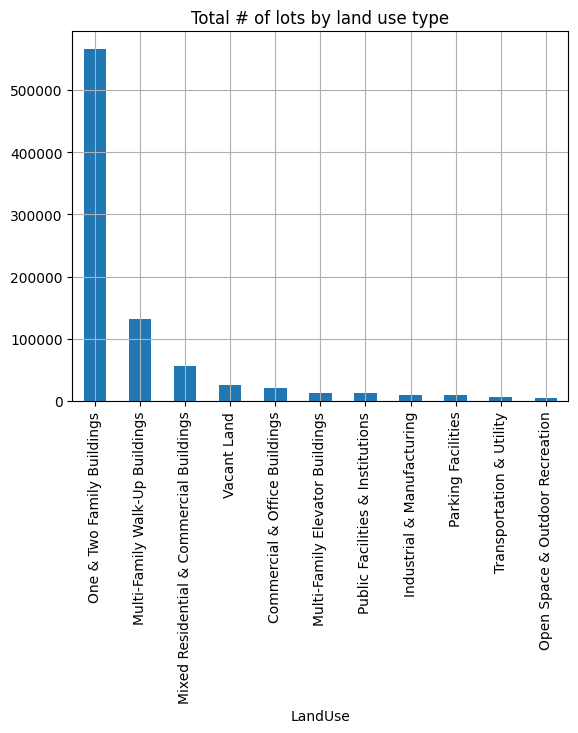

In [11]:
pluto_ogrio["LandUse"].value_counts().plot.bar()
plt.grid()
plt.title("Total # of lots by land use type")

Text(0.5, 1.0, 'Total lot area by land use type')

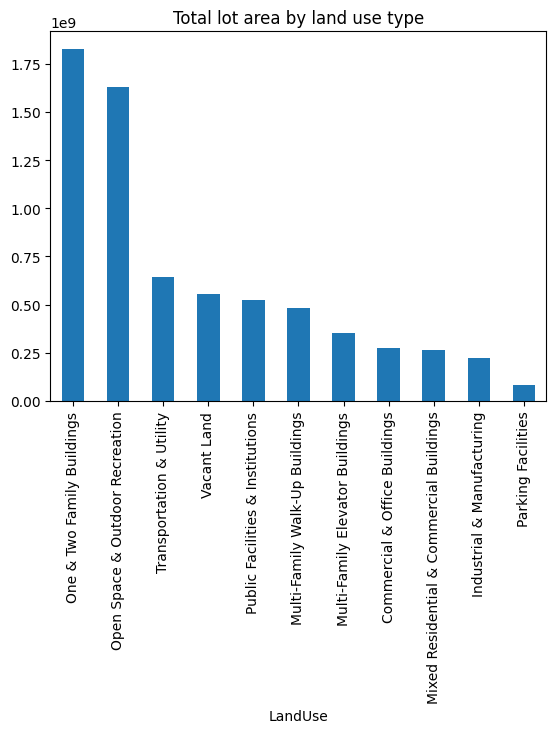

In [12]:
pluto_ogrio.groupby("LandUse").LotArea.sum().sort_values(ascending=False).plot.bar()
plt.title("Total lot area by land use type")

Text(0.5, 1.0, 'Total building area by land use type')

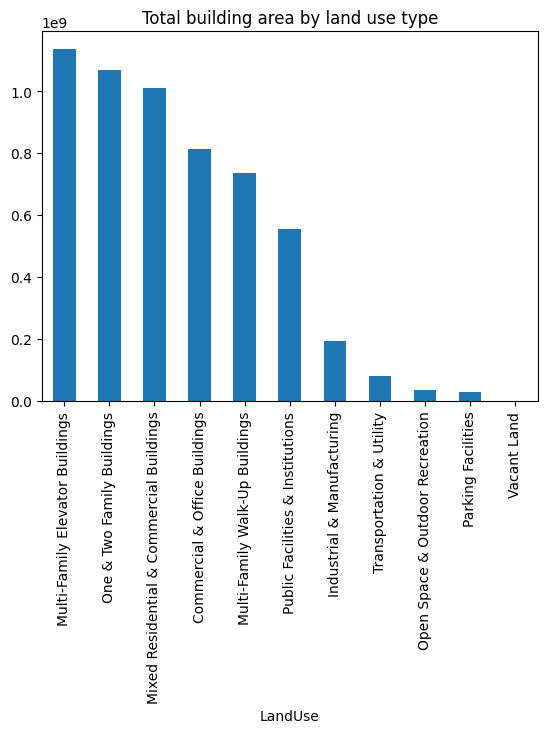

In [13]:
# now the same but for building area
pluto_ogrio.groupby("LandUse").BldgArea.sum().sort_values(ascending=False).plot.bar()
plt.title("Total building area by land use type")

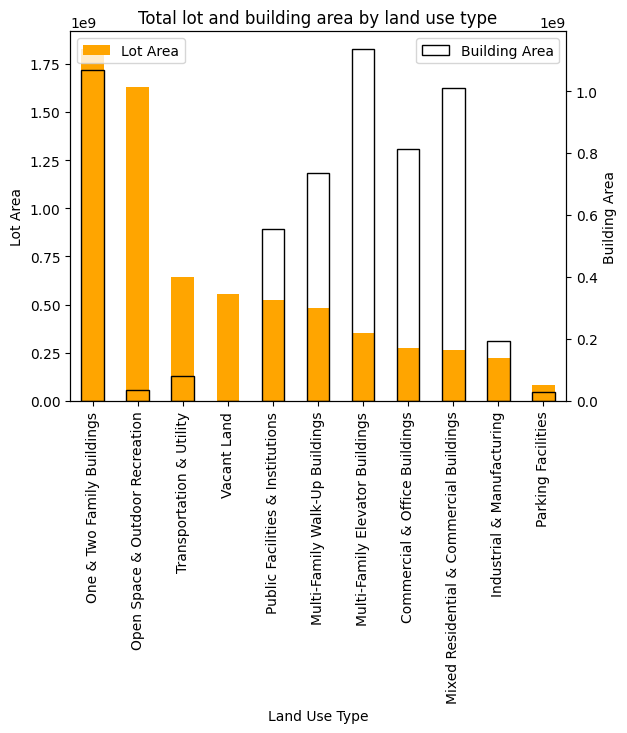

In [14]:
# plot both lot and building area on the same plot with a secondary y-axis
fig, ax = plt.subplots()
by_lot_area = pluto_ogrio.groupby("LandUse").LotArea.sum().sort_values(ascending=False)

by_lot_area.plot.bar(ax=ax, color="orange")

# get order to apply below
order = {v: i for i, v in enumerate(by_lot_area.index)}

ax.set_ylabel("Lot Area")
ax.set_xlabel("Land Use Type")

ax2 = ax.twinx()
pluto_ogrio.groupby("LandUse").BldgArea.sum().reindex(by_lot_area.index).plot.bar(
    ax=ax2, edgecolor="black", color="none"
)
ax2.set_ylabel("Building Area")

plt.title("Total lot and building area by land use type")

# add legends
ax.legend(["Lot Area"], loc="upper left")
ax2.legend(["Building Area"], loc="upper right")

## numeric column


In [15]:
pluto_ogrio["NumFloors"].describe()

count    856819.000000
mean          2.357554
std           2.012707
min           0.000000
25%           2.000000
50%           2.000000
75%           2.500000
max         104.000000
Name: NumFloors, dtype: float64

<Axes: ylabel='Frequency'>

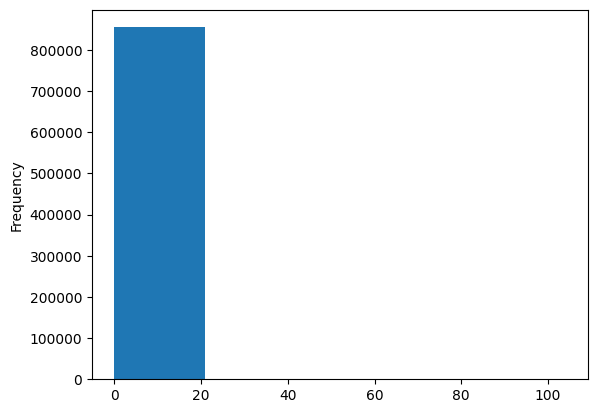

In [16]:
pluto_ogrio["NumFloors"].plot.hist(bins=5)

<Axes: title={'center': 'NumFloors'}, xlabel='Borough'>

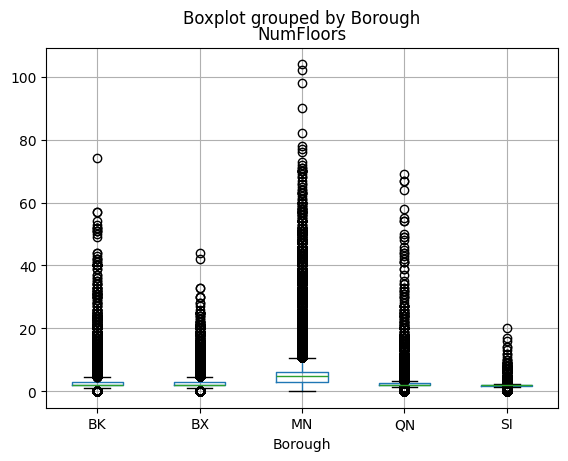

In [17]:
pluto_ogrio.boxplot(column="NumFloors", by="Borough")

<Axes: ylabel='Frequency'>

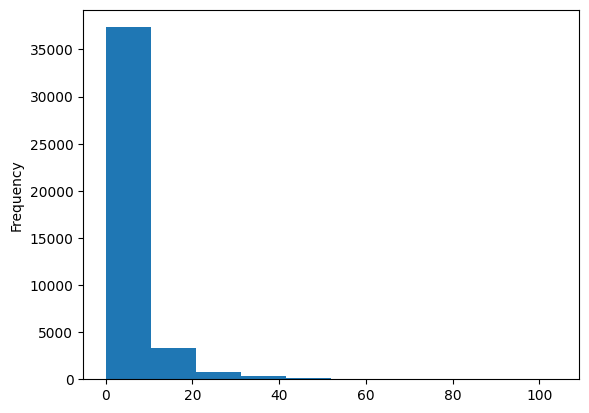

In [18]:
pluto_ogrio[pluto_ogrio.Borough.eq("MN")]["NumFloors"].plot.hist(bins=10)

In [19]:
# get clusters using kmeans
kmeans = KMeans(n_clusters=5)
kmeans.fit(pluto_ogrio[["NumFloors"]])

pluto_ogrio["NumFloorsCluster"] = kmeans.predict(pluto_ogrio[["NumFloors"]])

In [20]:
pluto_ogrio.groupby("NumFloorsCluster").NumFloors.describe().sort_values("max")

,count,mean,std,min,25%,50%,75%,max
NumFloorsCluster,,,,,,,,
4,114841.0,0.638955,0.480502,0.00,0.0,1.0,1.0,1.35
1,547744.0,2.065900,0.243118,1.40,2.0,2.0,2.0,2.85
0,186619.0,3.655061,1.077201,2.87,3.0,3.0,4.0,8.50
3,6588.0,14.183515,4.309663,9.00,11.0,13.0,16.0,26.00
2,1027.0,38.451315,10.537900,27.00,31.0,35.0,43.0,104.00


<Axes: xlabel='NumFloors', ylabel='BldgArea'>

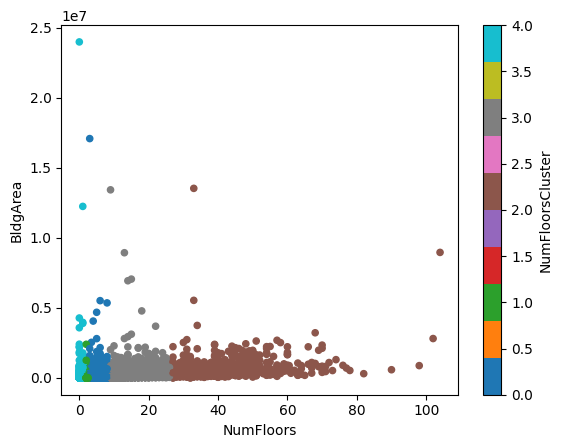

In [21]:
pluto_ogrio.plot.scatter(
    x="NumFloors", y="BldgArea", c="NumFloorsCluster", cmap="tab10"
)

<Axes: ylabel='Frequency'>

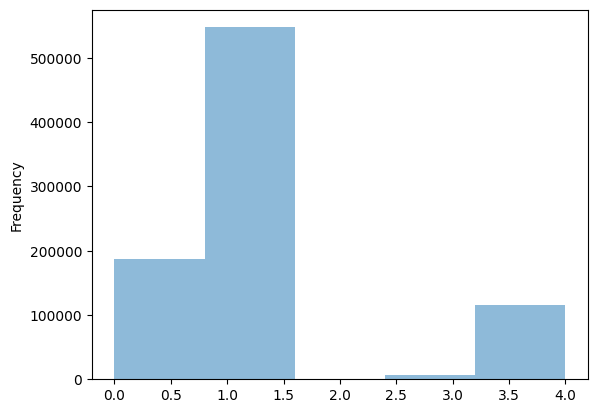

In [22]:
pluto_ogrio["NumFloorsCluster"].plot.hist(bins=5, alpha=0.5)

# and now, mapping


## static map


Text(0.5, 1.0, 'NYC MapPLUTO')

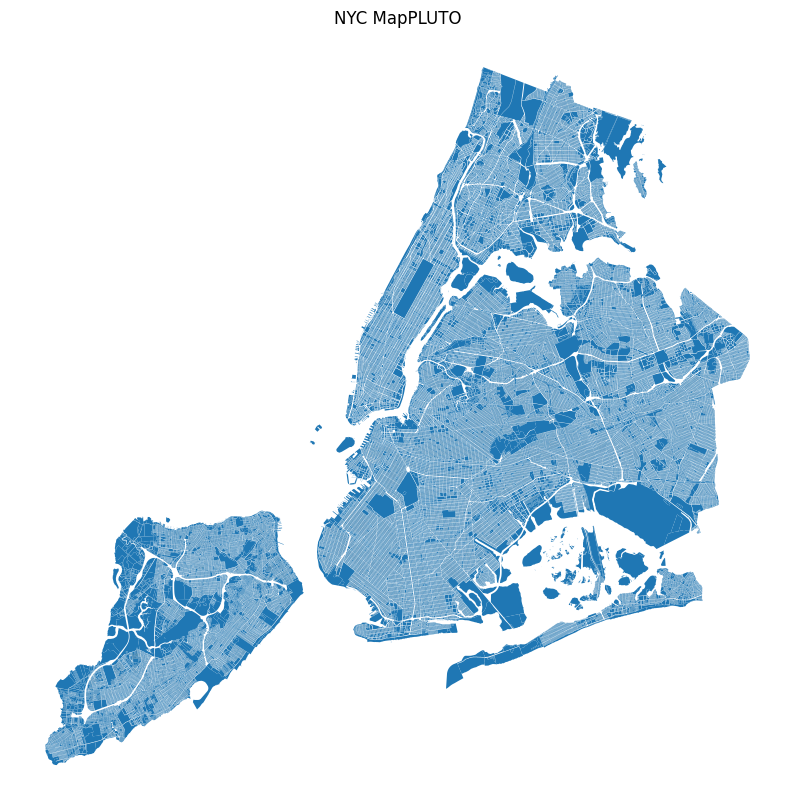

In [23]:
pluto_ogrio.plot(figsize=(10, 10)).set_axis_off()
plt.title("NYC MapPLUTO")

In [24]:
cmap = {
    "One & Two Family Buildings": "#ff0000",
    "Multi-Family Walk-Up Buildings": "#00ff00",
    "Multi-Family Elevator Buildings": "#0000ff",
    "Mixed Residential & Commercial Buildings": "#ff00ff",
    "Commercial & Office Buildings": "#00ffff",
    "Industrial & Manufacturing": "#ffff00",
    "Transportation & Utility": "#808080",
    "Public Facilities & Institutions": "#800000",
    "Open Space & Outdoor Recreation": "#008000",
    "Parking Facilities": "#000080",
    "Vacant Land": "#800080",
    "Unknown": "#000000",
}

In [25]:
pluto_ogrio.fillna({"LandUse": "Unknown"}, inplace=True)

In [26]:
pluto_ogrio["color"] = pluto_ogrio["LandUse"].map(cmap)

# prep for interactive mapping


In [27]:
pluto_ogrio_wgs = pluto_ogrio.to_crs("epsg:4326")

## visualize a categorical variable


In [28]:
cmap_rgb = {k: list(int(v[i : i + 2], 16) for i in (1, 3, 5)) for k, v in cmap.items()}

In [29]:
cmap_rgb

{'One & Two Family Buildings': [255, 0, 0],
 'Multi-Family Walk-Up Buildings': [0, 255, 0],
 'Multi-Family Elevator Buildings': [0, 0, 255],
 'Mixed Residential & Commercial Buildings': [255, 0, 255],
 'Commercial & Office Buildings': [0, 255, 255],
 'Industrial & Manufacturing': [255, 255, 0],
 'Transportation & Utility': [128, 128, 128],
 'Public Facilities & Institutions': [128, 0, 0],
 'Open Space & Outdoor Recreation': [0, 128, 0],
 'Parking Facilities': [0, 0, 128],
 'Vacant Land': [128, 0, 128],
 'Unknown': [0, 0, 0]}

In [30]:
len(pluto_ogrio_wgs[pluto_ogrio_wgs["LandUse"].isna()])

0

In [31]:
pluto_ogrio_wgs["LandUse"].fillna("Unknown", inplace=True)

/var/folders/g5/b592wl6x12s0tx4jfw9f7_j40000gn/T/ipykernel_4166/961482650.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  pluto_ogrio_wgs["LandUse"].fillna("Unknown", inplace=True)


In [32]:
df = pluto_ogrio_wgs[["LandUse", "geometry"]]

layer = PolygonLayer.from_geopandas(
    df[["LandUse", "geometry"]],
    get_fill_color=apply_categorical_cmap(df["LandUse"], cmap=cmap_rgb),
)
m = Map(layer)
m

Map(layers=[PolygonLayer(get_fill_color=<pyarrow.lib.FixedSizeListArray object at 0x1847cec80>
[
  [
    128,
…

In [33]:
pluto_ogrio_wgs["LandUse"] = pluto_ogrio_wgs["LandUse"].astype("category")

In [34]:
df = pluto_ogrio_wgs[["LandUse", "geometry"]]

layer = PolygonLayer.from_geopandas(
    df[["LandUse", "geometry"]],
    get_fill_color=apply_categorical_cmap(df["LandUse"], cmap=cmap_rgb),
)
m = Map(layer)
m

Map(layers=[PolygonLayer(get_fill_color=<pyarrow.lib.FixedSizeListArray object at 0x1847cf4c0>
[
  [
    128,
…

In [35]:
import pandas as pd

In [36]:
pluto_ogrio_wgs.columns

Index(['Borough', 'Block', 'Lot', 'CD', 'BCT2020', 'BCTCB2020', 'CT2010',
       'CB2010', 'SchoolDist', 'Council', 'ZipCode', 'FireComp', 'PolicePrct',
       'HealthCent', 'HealthArea', 'Sanitboro', 'SanitDistr', 'SanitSub',
       'Address', 'ZoneDist1', 'ZoneDist2', 'ZoneDist3', 'ZoneDist4',
       'Overlay1', 'Overlay2', 'SPDist1', 'SPDist2', 'SPDist3', 'LtdHeight',
       'SplitZone', 'BldgClass', 'LandUse', 'Easements', 'OwnerType',
       'OwnerName', 'LotArea', 'BldgArea', 'ComArea', 'ResArea', 'OfficeArea',
       'RetailArea', 'GarageArea', 'StrgeArea', 'FactryArea', 'OtherArea',
       'AreaSource', 'NumBldgs', 'NumFloors', 'UnitsRes', 'UnitsTotal',
       'LotFront', 'LotDepth', 'BldgFront', 'BldgDepth', 'Ext', 'ProxCode',
       'IrrLotCode', 'LotType', 'BsmtCode', 'AssessLand', 'AssessTot',
       'ExemptTot', 'YearBuilt', 'YearAlter1', 'YearAlter2', 'HistDist',
       'Landmark', 'BuiltFAR', 'ResidFAR', 'CommFAR', 'FacilFAR', 'BoroCode',
       'BBL', 'CondoNo', 'Tract2

In [37]:
pd.DataFrame(pluto_ogrio_wgs[["LandUse", "geometry"]])

,LandUse,geometry
0,Public Facilities & Institutions,"POLYGON ((-74.01208 40.69205, -74.01215 40.692..."
1,Multi-Family Walk-Up Buildings,"POLYGON ((-74.00202 40.70791, -74.00198 40.707..."
2,Mixed Residential & Commercial Buildings,"POLYGON ((-74.00213 40.70784, -74.00199 40.707..."
3,Mixed Residential & Commercial Buildings,"POLYGON ((-74.00231 40.70776, -74.00224 40.707..."
4,Mixed Residential & Commercial Buildings,"POLYGON ((-74.00271 40.70731, -74.00278 40.707..."
...,...,...
856814,One & Two Family Buildings,"POLYGON ((-74.25065 40.50927, -74.25055 40.509..."
856815,One & Two Family Buildings,"POLYGON ((-74.25009 40.50929, -74.25015 40.509..."
856816,One & Two Family Buildings,"POLYGON ((-74.24997 40.50916, -74.25004 40.509..."
856817,One & Two Family Buildings,"POLYGON ((-74.24983 40.50903, -74.24990 40.509..."


In [38]:
pluto_ogrio_wgs[pluto_ogrio_wgs.geometry.isna()]

,Borough,Block,Lot,CD,BCT2020,BCTCB2020,CT2010,CB2010,SchoolDist,Council,...,Version,DCPEdited,Latitude,Longitude,Notes,Shape_Leng,Shape_Area,geometry,NumFloorsCluster,color


In [48]:
# plot using pydeck

layer = pdk.Layer(
    "GeoJsonLayer",
    data=pd.DataFrame(pluto_ogrio_wgs[["LandUse", "geometry"]]),
    get_polygon="geometry.coordinates",
    get_fill_color=[255, 255, 0],
    pickable=True,
    auto_highlight=True,
    # use_binary_transport=True,
)

view_state = pdk.ViewState(latitude=40.7, longitude=-74, zoom=10)

r = pdk.Deck(layers=[layer], initial_view_state=view_state)
r.to_html("pluto.html")

TypeError: vars() argument must have __dict__ attribute

In [41]:
import folium

In [42]:
# now use folium to plot the polygons
m = folium.Map(location=[40.7, -74], zoom_start=10)

for i, row in pluto_ogrio_wgs[pluto_ogrio_wgs.CD.eq(307)].iterrows():
    folium.GeoJson(
        row.geometry,
        style_function=lambda x: {"fillColor": cmap_rgb[row.LandUse], "color": "black"},
    ).add_to(m)

m

## visualize a continuous variable


In [ ]:
df = pluto_ogrio_wgs[["NumFloors", "geometry"]]

normalizer = LogNorm(1, df.NumFloors.max(), clip=True)
normalized_floors = normalizer(df.NumFloors)

layer = PolygonLayer.from_geopandas(
    df[["NumFloors", "geometry"]],
    get_fill_color=apply_continuous_cmap(normalized_floors, cmap=PuRd_9),
)
m = Map(layer)
m

In [50]:
from IPython.display import HTML

In [53]:
# Python variables
fgb_url = "mappluto_ogr.fgb"
initial_lat = 40.7
initial_lon = -74
initial_zoom = 13

# HTML code with placeholders for Python variables
html_code = f"""
<!DOCTYPE html>
<html>
<head>
    <title>Leaflet Map with FlatGeobuf</title>
    <meta charset="utf-8" />
    <meta name="viewport" content="width=device-width, initial-scale=1.0">
    <link rel="stylesheet" href="https://unpkg.com/leaflet/dist/leaflet.css" />
    <script src="https://unpkg.com/leaflet/dist/leaflet.js"></script>
    <script src="https://unpkg.com/flatgeobuf/flatgeobuf.js"></script>
    <style>
        #map {{ height: 600px; width: 100%; }}
    </style>
</head>
<body>
    <div id="map"></div>
    <script>
        // Initialize the map
        var map = L.map('map').setView([{initial_lat}, {initial_lon}], {initial_zoom});

        // Add a tile layer
        L.tileLayer('https://{{s}}.tile.openstreetmap.org/{{z}}/{{x}}/{{y}}.png', {{
            maxZoom: 19
        }}).addTo(map);

        // Load the .fgb file and add it to the map
        fetch('{fgb_url}')
            .then(response => response.arrayBuffer())
            .then(data => {{
                var geojson = flatgeobuf.deserialize(data);
                L.geoJSON(geojson).addTo(map);
            }})
            .catch(err => console.error(err));
    </script>
</body>
</html>
"""

# Display the HTML
HTML(html_code)

# save data


In [ ]:
# save out as fgb using geopandas
# pluto_ogrio.to_file("..Data/nyc_mappluto_24v1_1_shp/mappluto.fgb")

In [ ]:
# ogr.write_dataframe(pluto_ogrio, "../Data/nyc_mappluto_24v1_1_shp/mappluto_ogr.fgb")